In [1]:
import pandas as pd

df = pd.read_csv('laptops_10.csv', sep=',')
df.head()

,Company,Product,TypeName,Inches,Cpu,Ram,Gpu,OpSys,Weight,Price_euros,Cpu_Company,Memory_Amount,Memory_Type
0,Apple,MacBook Pro,Ultrabook,13.3,Intel Core i5 2.3GHz,8GB,Intel Iris Plus Graphics 640,macOS,1.37,1339.69,Intel,128,SSD
1,Apple,Macbook Air,Ultrabook,13.3,Intel Core i5 1.8GHz,8GB,Intel HD Graphics 6000,macOS,1.34,898.94,Intel,128,FlashStorage
2,HP,250 G6,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8GB,Intel HD Graphics 620,No OS,1.86,575.00,Intel,256,SSD
3,Apple,MacBook Pro,Ultrabook,15.4,Intel Core i7 2.7GHz,16GB,AMD Radeon Pro 455,macOS,1.83,2537.45,Intel,512,SSD
4,Apple,MacBook Pro,Ultrabook,13.3,Intel Core i5 3.1GHz,8GB,Intel Iris Plus Graphics 650,macOS,1.37,1803.60,Intel,256,SSD


1.1 Изучите количество памяти с помощью matplotlib
- Постройте график
- Назовите график
- Сделайте именование оси x и оси y
- Сделайте выводы

Text(0, 0.5, 'Количество')

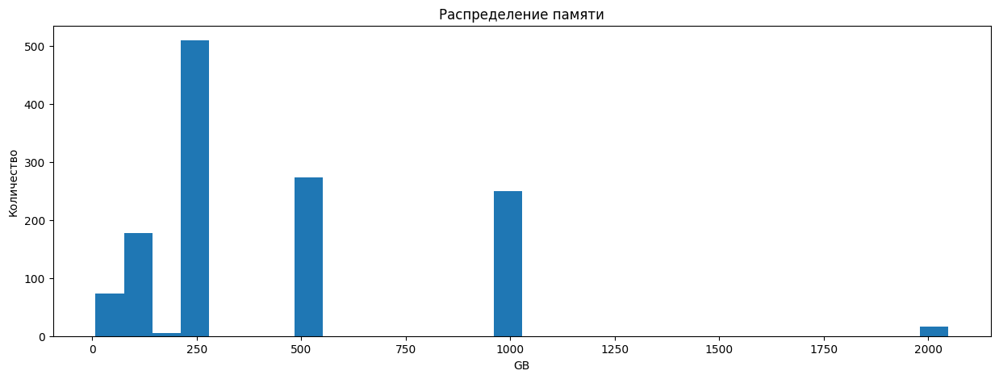

In [2]:
import matplotlib.pyplot as plt

plt.figure(figsize = (15,5))
plt.hist(df['Memory_Amount'], bins = 30)
plt.title('Распределение памяти')
plt.xlabel('GB')
plt.ylabel('Количество')

1.2 Изучите стоимость ноутбуков с помощью matplotlib

- Постройте график
- Назовите график
- Сделайте именование оси x и оси y
- Сделайте выводы

Text(0, 0.5, 'Количество')

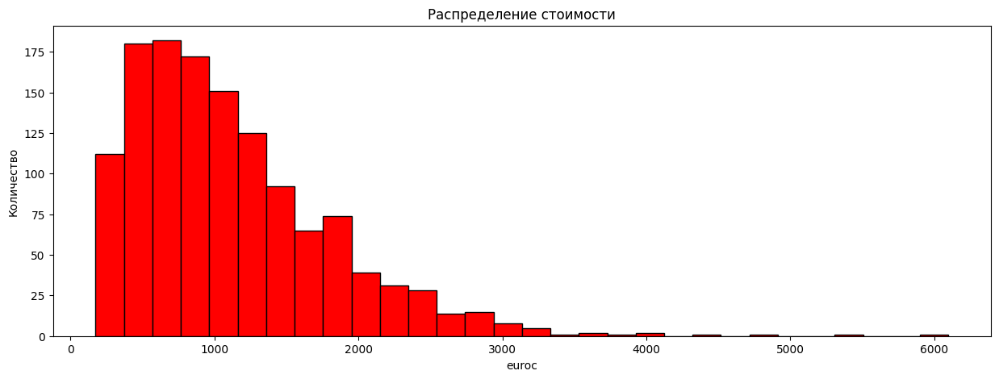

In [3]:
plt.figure(figsize = (15,5))
plt.hist(df['Price_euros'], color = 'red', edgecolor='black', bins = 30)
plt.title('Распределение стоимости')
plt.xlabel('euroc')
plt.ylabel('Количество')

1.3 Изучите вес ноутбуков с помощью matplotlib
- Постройте график
- Назовите график
- Сделайте именование оси x и оси y
- Сделайте выводы

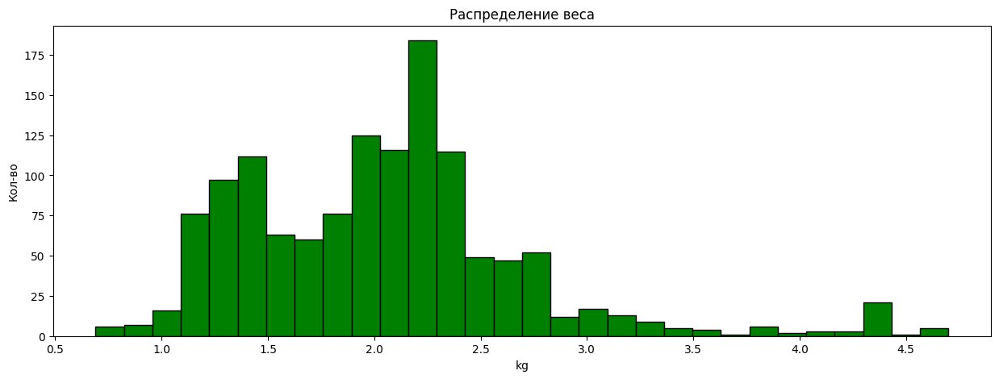

In [4]:
plt.figure(figsize=(15, 5))
plt.hist(df['Weight'], color='green', edgecolor='black', bins=30)
plt.title('Распределение веса')
plt.xlabel('kg')
plt.ylabel('Кол-во');

2.1 Изучите распределение типов носителя
- Постройте график
- Сделайте выводы 

In [5]:
data = df['Memory_Type'].value_counts()
names = data.index
values = data.values
data


Memory_Type
SSD             641
HDD             576
FlashStorage     74
Hybrid           12
Name: count, dtype: int64

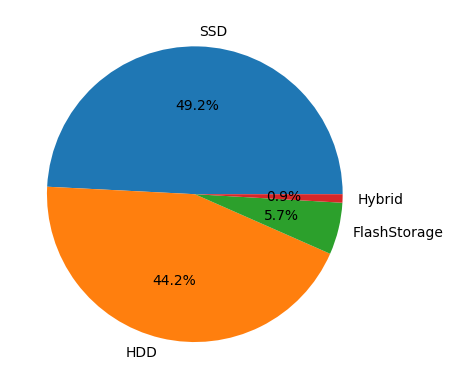

In [6]:
plt.pie(values, labels=names, autopct='%.1f%%');

2.2 Изучите распределение компаний производителей
- Постройте график
- Сделайте выводы


In [7]:
data = df['Company'].value_counts()
data


Company
Dell         297
Lenovo       297
HP           274
Asus         158
Acer         103
MSI           54
Toshiba       48
Apple         21
Samsung        9
Razer          7
Mediacom       7
Microsoft      6
Xiaomi         4
Vero           4
Chuwi          3
Google         3
Fujitsu        3
LG             3
Huawei         2
Name: count, dtype: int64

In [8]:
names = data.index
values = data.values

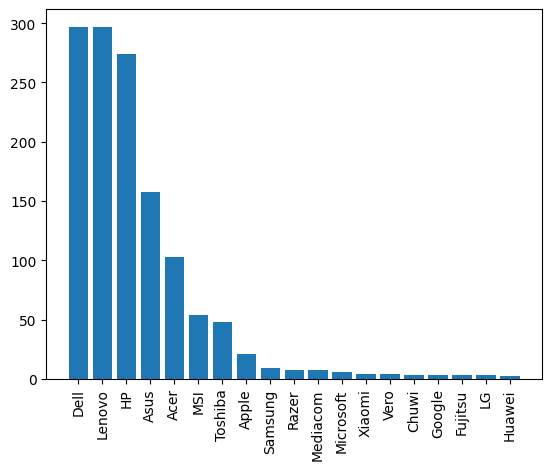

In [9]:
plt.bar(names, values)
plt.xticks(rotation=90);

2.3 Изучите распределение операционной системы
- Постройте график
- Сделайте выводы

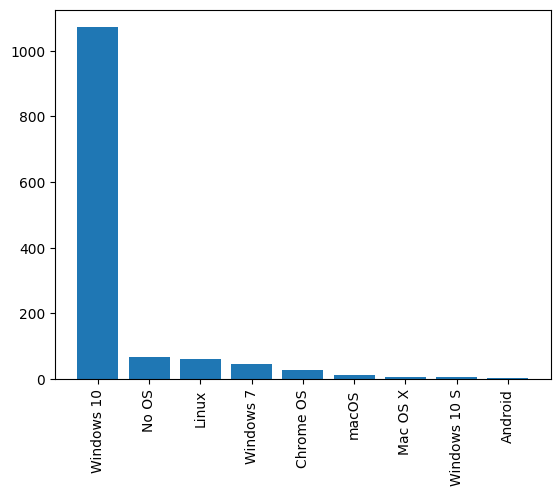

In [10]:
data = df['OpSys'].value_counts()

names = data.index
values = data.values

plt.bar(names, values)
plt.xticks(rotation=90);

2.4 Изучите распределение компаний производителей CPU
- Постройте график
- Сделайте выводы

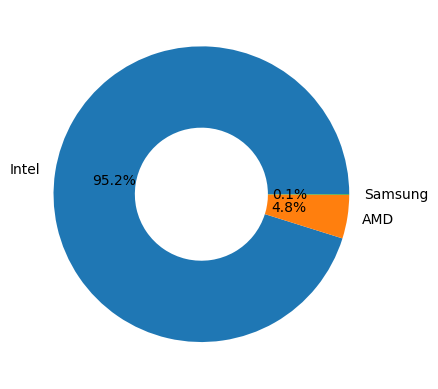

In [11]:
data = df['Cpu_Company'].value_counts()

names = data.index
values = data.values

plt.pie(values, labels=names, autopct='%.1f%%', wedgeprops=dict(width=0.55));

#### 3 задача

Изучите взаимосвязь компаний производителей ноутбуков и компаний производителей процессоров, используя сложенную или многорядовую столбчатую диаграмму

Процессоры от Samsung не изучайте

3.1 Постройте график в абсолютных величинах


In [12]:
data = pd.crosstab(index=df['Company'], columns=df['Cpu_Company'])
data = data.drop(columns=['Samsung']).reset_index()
data

Cpu_Company,Company,AMD,Intel
0,Acer,10,93
1,Apple,0,21
2,Asus,11,147
3,Chuwi,0,3
4,Dell,0,297
5,Fujitsu,0,3
6,Google,0,3
7,HP,25,249
8,Huawei,0,2
9,LG,0,3


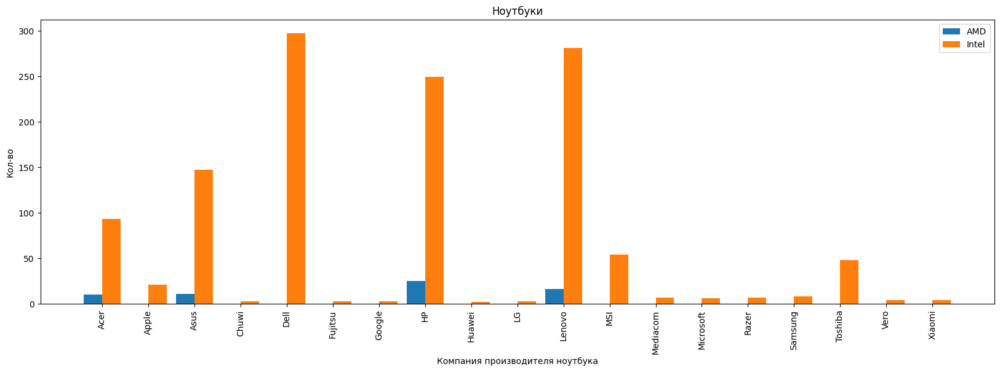

In [13]:
import numpy as np

plt.figure(figsize=(20, 6))

n_ticks = np.arange(len(data['AMD']))
offset = 0.2
w = 0.4

plt.bar(n_ticks - offset, data['AMD'], width=w)
plt.bar(n_ticks + offset, data['Intel'], width=w)

plt.title('Ноутбуки')
plt.xlabel('Компания производителя ноутбука')
plt.ylabel('Кол-во')
plt.legend(['AMD', 'Intel'])
plt.xticks(n_ticks, data['Company'], rotation=90);

3.2 Постройте график в относительных величинах


In [14]:
data = pd.crosstab(index=df['Company'], columns=df['Cpu_Company'], normalize='index')
data = data.drop(columns=['Samsung']).reset_index()
data

Cpu_Company,Company,AMD,Intel
0,Acer,0.097087,0.902913
1,Apple,0.000000,1.000000
2,Asus,0.069620,0.930380
3,Chuwi,0.000000,1.000000
4,Dell,0.000000,1.000000
5,Fujitsu,0.000000,1.000000
6,Google,0.000000,1.000000
7,HP,0.091241,0.908759
8,Huawei,0.000000,1.000000
9,LG,0.000000,1.000000


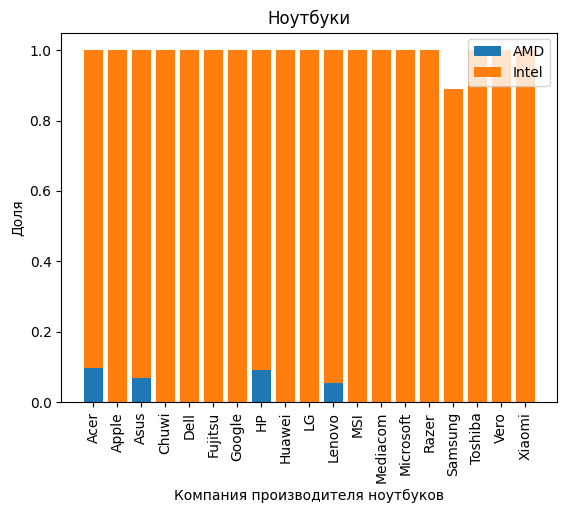

In [15]:
plt.bar(data['Company'], data['AMD'])
plt.bar(data['Company'], data['Intel'], bottom=data['AMD'])

plt.title('Ноутбуки')
plt.xlabel('Компания производителя ноутбуков')
plt.ylabel('Доля')
plt.legend(['AMD', 'Intel'])
plt.xticks(rotation=90);

4.1 Изучите взаимосвязь стоимости ноутбука и компании производителя процессора
- Постройте график
- Назовите график
- Сделайте именование оси x и оси y
- Сделайте выводы


In [1]:
import seaborn as sns

sns.boxplot(x=df['Price_euros'], y=df['Cpu_Company'])

plt.title('взаимосвязь стоимости ноутбука и компании производителя процессора')
plt.xlabel('Price_euros')
plt.ylabel('Cpu_Company');

NameError: name 'df' is not defined

4.2 Изучите взаимосвязь стоимости ноутбука и типа носителя памяти
- Постройте график
- Назовите график
- Сделайте именование оси x и оси y
- Сделайте выводы

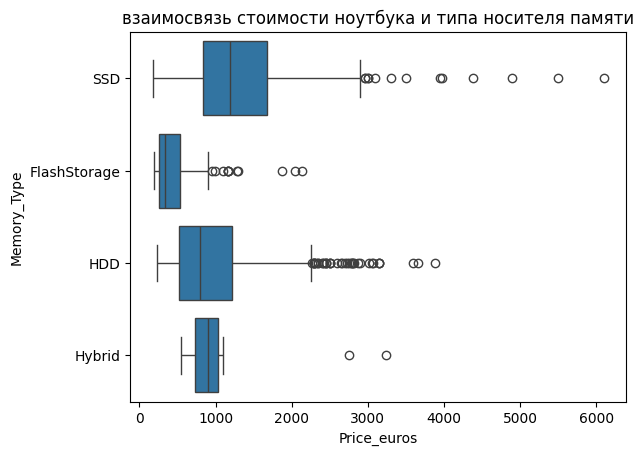

In [20]:
sns.boxplot(x=df['Price_euros'], y=df['Memory_Type'])

plt.title('взаимосвязь стоимости ноутбука и типа носителя памяти')
plt.xlabel('Price_euros')
plt.ylabel('Memory_Type');

4.3 Изучите взаимосвязь стоимости ноутбука и кол-ва оперативной памяти
- Постройте график
- Назовите график
- Сделайте именование оси x и оси y
- Сделайте выводы


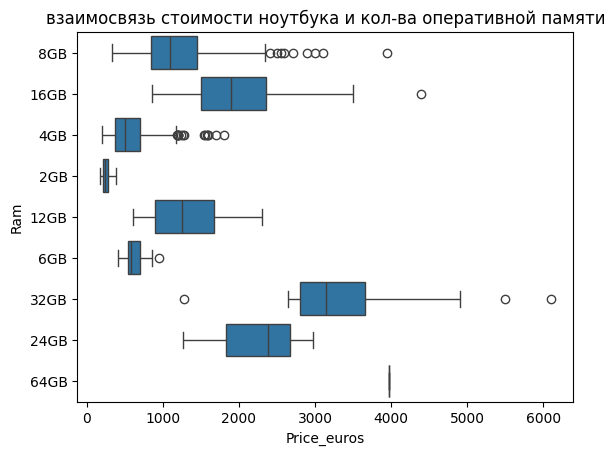

In [21]:
sns.boxplot(x=df['Price_euros'], y=df['Ram'])

plt.title('взаимосвязь стоимости ноутбука и кол-ва оперативной памяти')
plt.xlabel('Price_euros')
plt.ylabel('Ram');

4.4 Изучите взаимосвязь стоимости ноутбука и компании производителя
- Постройте график
- Назовите график
- Сделайте именование оси x и оси y
- Сделайте выводы

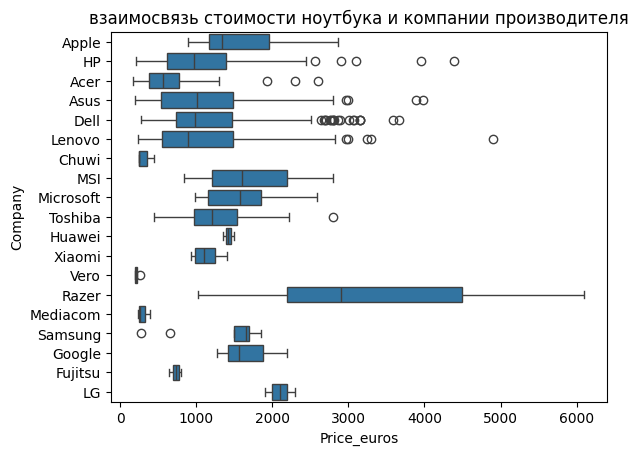

In [22]:
sns.boxplot(x=df['Price_euros'], y=df['Company'])

plt.title('взаимосвязь стоимости ноутбука и компании производителя')
plt.xlabel('Price_euros')
plt.ylabel('Company');

C:\Users\Anna\AppData\Local\Temp\ipykernel_11548\2782407560.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=df['Price_euros'], y=df['Company'], palette=colors)
C:\Users\Anna\AppData\Local\Temp\ipykernel_11548\2782407560.py:3: UserWarning: The palette list has more values (20) than needed (19), which may not be intended.
  sns.boxplot(x=df['Price_euros'], y=df['Company'], palette=colors)


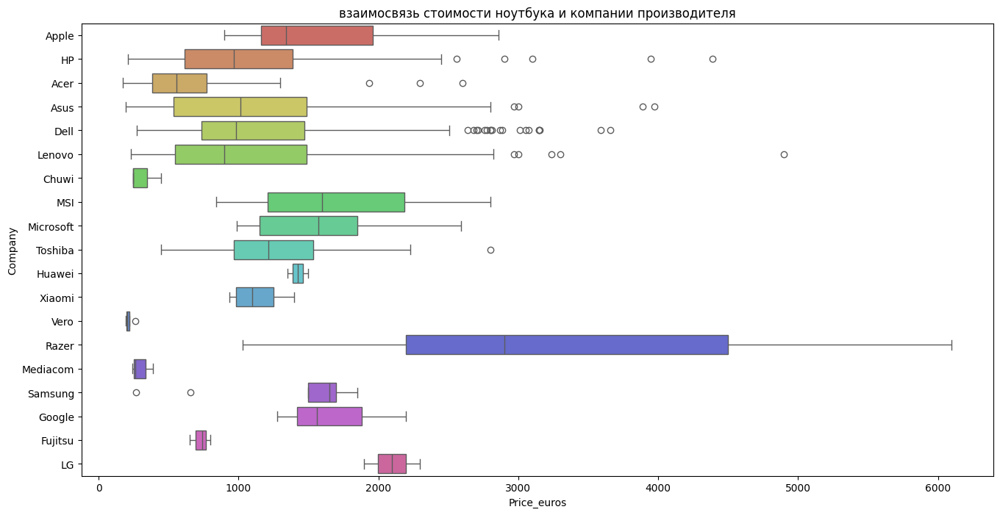

In [38]:
plt.figure(figsize=(16, 8))
colors = sns.color_palette("hls", 20)
sns.boxplot(x=df['Price_euros'], y=df['Company'], palette=colors)

plt.title('взаимосвязь стоимости ноутбука и компании производителя')
plt.xlabel('Price_euros')
plt.ylabel('Company');

5 задача*

Постройте матрицу корреляций для таблицы


In [34]:
corr_matrix = df[['Inches', 'Weight', 'Price_euros', 'Memory_Amount']].corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix


,Inches,Weight,Price_euros,Memory_Amount
Inches,1.0,0.8,0.0,0.3
Weight,0.8,1.0,0.0,0.0
Price_euros,0.0,0.0,1.0,0.0
Memory_Amount,0.3,0.0,0.0,1.0


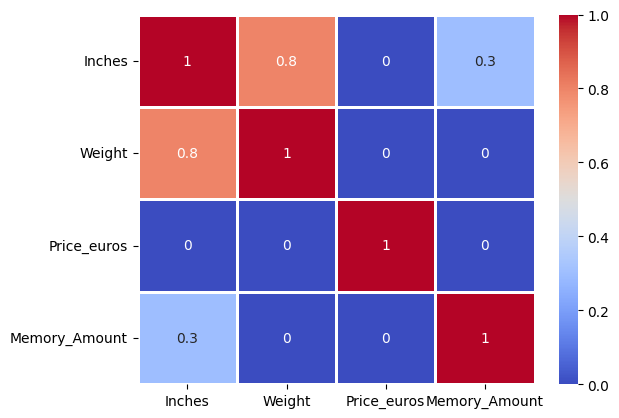

In [39]:
sns.heatmap(corr_matrix, annot=True, linewidth=1, cmap='coolwarm');

In [43]:
# !pip install folium

In [44]:
df = pd.read_csv('kc_house_data.csv', sep=',')
df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,20140521T000000,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,20150223T000000,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,20140623T000000,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,20150116T000000,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


In [46]:
import folium

this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.lat, point.long],
        radius=2,
        popup={'price': point.price, 'floors': point.floors}).add_to(this_map)

df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map